### First we read the features from the HDF5 file and store hem into a numpy ndarray

In [1]:
from __future__ import print_function
import numpy as np
import h5py
from PIL import Image
import matplotlib.pyplot as plt

import sys
sys.path.insert(0, './../scikit_learn')
sys.path.insert(0, './../')
from sklearn.cluster import AgglomerativeClustering_dist
from sklearn.decomposition import PCA

import time

from utils_clust import normalizing_samples_L2, loading_images, searching_similar_images

/home/eric/.local/lib/python2.7/site-packages/h5py/__init__.py:34: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [19]:
# To save pairs of children...
iteration_nb = '001'
path_pairs_out = './clusters/best_model/image_pairs' + iteration_nb
#path_pairs_out_int_nodes = './image_int_nodes' + iteration_nb
path_pairs_out_larger_clusters = './clusters/best_model/image_pairs_mixed_nodes' + iteration_nb

# Define the paths
features_path = './features_maxpool_allConv.hdf5'
image_names_path = '/features_maxpool_allConv.txt'

# source images
# 1st iteration path
images_path = '../../surrogate_dataset/training_set_100000/'

# 2nd iteration path
#images_path = './images_2nd_iteration/'

# 3rd iteration path
#images_path = './images_3rd_iteration/'

# 4th iteration path
#images_path = './images_4th_iteration/'

In [3]:
# load images
samples = loading_images(features_path)
# normalize images
samples_L2 = normalizing_samples_L2(samples)

Dimension of the features:3440
Number of samples:100000


In [4]:
# we only want 50k images by now
samples = samples[:50000]
samples_L2 = samples_L2[:50000]

In [5]:
# defining and fitting the PCA
pca_red = PCA(n_components = 1792, whiten = True)
pca_red.fit(samples_L2)

# "reducing" the samples
samples_L2_pca = pca_red.transform(samples_L2)
print(samples_L2_pca.shape, samples_L2_pca[0].min(), \
      samples_L2_pca[0].max(), np.linalg.norm(samples_L2_pca[0]))

# normalizing the samples again
samples_L2_pca_L2 = normalizing_samples_L2(samples_L2_pca)
print(samples_L2_pca_L2.shape, samples_L2_pca_L2[0].min(), \
      samples_L2_pca_L2[0].max(), np.linalg.norm(samples_L2_pca_L2[0]))

(50000, 1792) -3.175181224952429 2.8094821941994965 40.247421392421835
(50000, 1792) -0.07889154423071396 0.06980527191559391 1.0000000000000002


In [6]:
# agglomerative clustering from scikit learn - 50000 SAMPLES 
linkage='complete' # ward, complete or average
clustering = AgglomerativeClustering_dist(linkage=linkage, 
                                          n_clusters=1, 
                                          compute_full_tree = True, 
                                          return_distance = True)
t0 = time.time()
clustering.fit(samples_L2_pca_L2)
print("Clustering time with %s and %d samples: %.2fs" % (linkage, len(samples_L2_pca_L2), time.time() - t0))

Clustering time with complete and 50000 samples: 1374.11s


In [5]:
# agglomerative clustering from scikit learn - ONLY 64000 SAMPLES

linkage='complete' # ward, complete or average
clustering = AgglomerativeClustering_dist(linkage=linkage, 
                                          n_clusters=1, 
                                          compute_full_tree = True, 
                                          return_distance = True)
t0 = time.time()
clustering.fit(samples_L2_pca_L2)
print("Clustering time with %s and %d samples: %.2fs" % (linkage, len(samples_L2_pca_L2), time.time() - t0))

Clustering time with complete and 64000 samples: 2990.17s


In [5]:
# agglomerative clustering from scikit learn - ONLY 32000 SAMPLES

linkage='complete' # ward, complete or average
clustering = AgglomerativeClustering_dist(linkage=linkage, 
                                          n_clusters=1, 
                                          compute_full_tree = True, 
                                          return_distance = True)
t0 = time.time()
clustering.fit(samples_L2_pca_L2)
print("Clustering time with %s and %d samples: %.2fs" % (linkage, len(samples_L2_pca_L2), time.time() - t0))

Clustering time with complete and 32000 samples: 513.02s


In [5]:
# agglomerative clustering from scikit learn - ONLY 16000 SAMPLES

linkage='complete' # ward, complete or average
clustering = AgglomerativeClustering_dist(linkage=linkage, 
                                          n_clusters=1, 
                                          compute_full_tree = True, 
                                          return_distance = True)
t0 = time.time()
clustering.fit(samples_L2_pca_L2)
print("Clustering time with %s and %d samples: %.2fs" % (linkage, len(samples_L2_pca_L2), time.time() - t0))

Clustering time with complete and 16315 samples: 136.11s


In [7]:
children = clustering.children_
distances = clustering.distances
# The leaves correspond to the samples introduced
leaves = clustering.n_leaves_
print("Number of leaves:", end = '')
print(leaves)

Number of leaves:50000


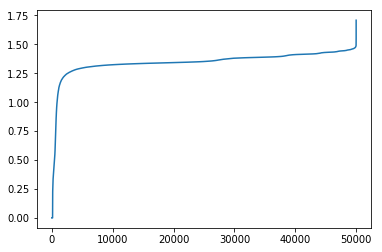

In [8]:
plt.plot(distances)
plt.show()

In [9]:
children.shape

(49999, 2)

# Working on larger clusters

In [10]:
# visualization of what we save in the file
threshold = 1.25
start = 0#1100#880
nb_im = len(children)#200

sub_child_int = []
sub_child_mixed = []

num =1
print ('Distances:')
plt.figure(figsize=(10,nb_im*4))
for idx, child in enumerate(children[start:start+nb_im]):
    #print (distances[start+idx], end = ' * ')
    if (child<leaves).all() and distances[start+idx]<threshold:
        # if both children from a particular node are leaves and 
        # the associated distance between them is less than thereshold 
        # the images associated to those leaves are clustered.
        print (distances[start+idx], end = ' * ')
        '''
        image = Image.open(images_path + str(child[0]).zfill(6) + '.png')
        plt.subplot(nb_im,2, num)
        num += 1
        plt.imshow(np.asarray(image))
        plt.axis('off')
        image = Image.open(images_path + str(child[1]).zfill(6) + '.png')
        plt.subplot(nb_im,2, num)
        num += 1
        plt.imshow(np.asarray(image))
        plt.axis('off')
        '''
        num += 1
        num += 1
        
    elif (child>=leaves).all() and distances[start+idx]<threshold:
        # if both children from a particular node are internal nodes
        sub_child_int.append(child)
        
    elif (child>=leaves).any() and distances[start+idx]<threshold:
        # if both children from a particular node are internal nodes
        sub_child_mixed.append(child)
        
print(end = '\n\n')
print("Nodes requested: ", end = '')
print(nb_im)
print("Nodes showed: ", end = '')
print((num-1)/2)
#plt.tight_layout()
plt.show()

Distances:
0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.0 * 0.10540867985870313 * 0.13182275520214018 * 0.14849366500257197 * 0.15140669858798425 * 0.15251517192668873 * 0.15321358931835266 * 0.1743273362321715 * 0.174343693324953 * 0.17468469616046378 * 0.18068977727188434 

Nodes requested: 49999
Nodes showed: 2272


In [11]:
print(sub_child_int)
print('')
print(sub_child_mixed)

[array([50021, 50022]), array([50216, 50335]), array([50302, 50613]), array([50570, 50750]), array([50759, 50817]), array([50444, 50521]), array([50800, 50938]), array([50133, 50187]), array([50347, 50358]), array([50803, 50980]), array([50207, 50942]), array([50916, 51000]), array([50261, 50834]), array([50217, 51048]), array([50006, 50007]), array([50947, 51060]), array([50440, 50543]), array([51188, 51230]), array([50741, 50810]), array([51213, 51383]), array([50908, 50986]), array([51360, 51373]), array([51097, 51248]), array([50777, 51450]), array([51041, 51100]), array([51187, 51226]), array([50815, 50929]), array([51064, 51525]), array([51114, 51454]), array([51366, 51713]), array([50788, 51161]), array([51051, 51502]), array([51445, 51793])]

[array([17945, 50156]), array([39597, 50012]), array([12880, 50146]), array([38079, 50034]), array([ 3742, 50162]), array([13275, 50015]), array([49896, 50281]), array([24679, 50068]), array([22738, 50332]), array([43173, 50313]), array([2

[17945, 16960, 41537]
[39597, 24740, 43922]
[12880, 24662, 48667]
[38079, 9106, 42620]
[3742, 10748, 45146]
[13275, 13117, 16365]
[49896, 9744, 25365]
[24679, 28075, 36832]
[22738, 705, 43598]
[43173, 49896, 9744, 25365]
[23539, 15656, 26372]
[44029, 14707, 27211]
[12076, 5483, 28119]
[102, 28498, 34056]
[3746, 1470, 7561]
[12579, 2683, 11552]
[37374, 26350, 34144]
[31547, 2923, 8904]
[30311, 35956, 41381]
[19055, 2839, 42561]
[4658, 6479, 23257]
[49416, 22423, 38617]


/home/eric/.local/lib/python2.7/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


[3050, 102, 28498, 34056]
[19688, 45387, 48783]
[3885, 16220, 22236]
[28541, 22126, 49934]
[36743, 15985, 40654]
[18510, 14395, 18798]
[44498, 9994, 21755]
[23995, 11915, 29113]
[15923, 21258, 32703]
[23918, 14868, 46663]
[8742, 12579, 2683, 11552]
[40618, 3721, 35690]
[19821, 12725, 33677]
[16455, 16753, 45279]
[24208, 18140, 32913]
[48825, 462, 35596]
[40609, 23918, 14868, 46663]
[48644, 6328, 38670]
[14651, 15041, 23782]
[43569, 41834, 44437]
[16139, 18510, 14395, 18798]
[48681, 16922, 41491]
[1734, 9374, 10129]
[6768, 5351, 45105]
[21734, 32525, 45962]
[14709, 2733, 34533]
[3593, 7309, 14752]
[27453, 18850, 41406]
[10800, 5678, 21931]
[18735, 20962, 41061]
[17480, 36743, 15985, 40654]
[49103]
[28784, 32598, 47501]
[31525, 14709, 2733, 34533]
[43664, 652, 36227]
[29635, 46898, 47992]
[24596, 14932, 22549]
[11533, 12960, 21487]
[28757, 13855, 48910]
[16711, 49103]
[42752, 4287, 19175]
[8517, 31124, 36368]
[35353, 6380, 15960]
[6307, 4464, 33751]
[48315, 17193, 43474]
[46200, 9685, 43

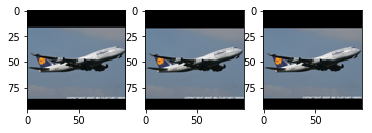

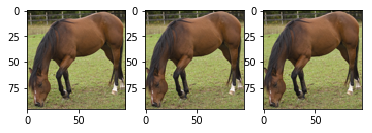

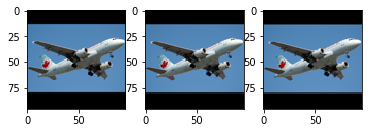

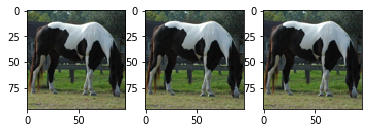

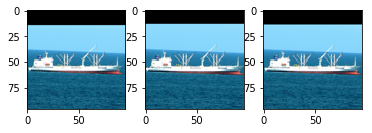

...

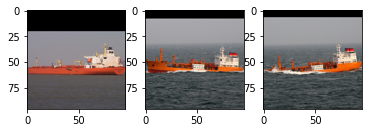

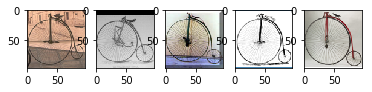

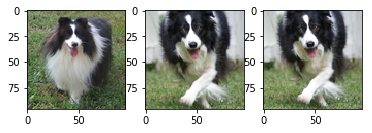

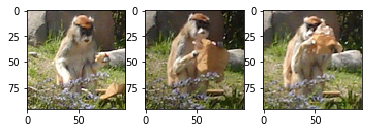

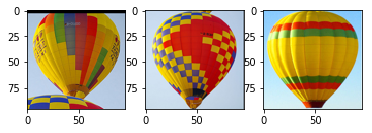

In [12]:
larger_clusters = []
num_3 = 0
num_4 = 0
num_5 = 0
num_6 = 0
num_7 = 0

for child in sub_child_mixed:
    plot_leaf = []
    plt.figure()
    plot_leaf.append(min(child))
    
    new_idx = max(child)-leaves
    if (children[new_idx]<leaves).all():
        plot_leaf.append(children[new_idx][0])
        plot_leaf.append(children[new_idx][1])
        
    elif(children[new_idx]<leaves).any():
        plot_leaf.append(min(children[new_idx]))
        new_idx = max(children[new_idx])-leaves
        
        if (children[new_idx]<leaves).all():
            plot_leaf.append(children[new_idx][0])
            plot_leaf.append(children[new_idx][1])
            
        elif(children[new_idx]<leaves).any():
            plot_leaf.append(min(children[new_idx]))
            #print("####### Another internal node ######")
            
            new_idx = max(children[new_idx])-leaves

            if (children[new_idx]<leaves).all():
                plot_leaf.append(children[new_idx][0])
                plot_leaf.append(children[new_idx][1])

            elif(children[new_idx]<leaves).any():
                plot_leaf.append(min(children[new_idx]))
                #print("####### Another internal node ######")
                
                new_idx = max(children[new_idx])-leaves

                if (children[new_idx]<leaves).all():
                    plot_leaf.append(children[new_idx][0])
                    plot_leaf.append(children[new_idx][1])
                    
                elif(children[new_idx]<leaves).any():
                    plot_leaf.append(min(children[new_idx]))
                    #print("####### Another internal node ######")
                    
                    new_idx = max(children[new_idx])-leaves

                    if (children[new_idx]<leaves).all():
                        plot_leaf.append(children[new_idx][0])
                        plot_leaf.append(children[new_idx][1])

                    elif(children[new_idx]<leaves).any():
                        plot_leaf.append(min(children[new_idx]))
                        print("####### Another internal node ######")
    
    nb_img = len(plot_leaf)
    num = 1
    
    if len(plot_leaf) == 3:
        num_3 += 1
    
    if len(plot_leaf) == 4:
        num_4 += 1
    
    if len(plot_leaf) == 5:
        num_5 += 1

    if len(plot_leaf) == 6:
        num_6 += 1
        
    if len(plot_leaf) == 7:
        num_7 += 1
    
    for img in plot_leaf:
        image = Image.open(images_path + str(img).zfill(6) + '.png')
        plt.subplot(1,nb_img, num)
        plt.imshow(np.asarray(image))
        num += 1
    print(plot_leaf)
    larger_clusters.append(plot_leaf)
plt.show()

In [13]:
num_3, num_4, num_5, num_6, num_7

(261, 48, 5, 1, 0)

[37505, 40984, 32607, 41686]
[36677, 47930, 4494, 18589]
[6425, 8859, 3050, 102, 28498, 34056]
[145, 30176, 9713, 36791]
[24692, 47742, 19643, 46848]
[31817, 46612, 8998, 44186]
[10800, 5678, 21931]
[26510, 38726, 17945, 16960, 41537]
[7678, 46580]
[3504, 5244, 33444, 17388, 42994]
[34870, 42080, 7412, 21568]
[12205, 41622, 16251, 42826]
[32114, 44653, 17480, 36743, 15985, 40654]
[13020, 47153, 34837, 31725, 42038]
[6869, 21340, 14618, 20554]
[34164, 12880, 24662, 48667, 42829, 5168, 26371]
[12447, 36564, 43349, 49318]
[18664, 32322, 791, 28757, 13855, 48910]
[16706, 26872, 6409, 47848]
[11511, 26906, 28189]
[15906, 32402, 15684, 48586]
[15093, 27219, 4924, 12928]
[7241, 2949, 34232, 7495, 31525, 14709, 2733, 34533]
[22014, 46355, 34027, 41114]
[8574, 30623, 27446, 44264]
[10802, 21011, 17881, 43648]
[7274, 14965, 16955, 30263]
[22944, 41175, 14429, 28925]
[16219, 23645, 82, 9093]
[13959, 15975, 4450, 29218]
[6826, 9205, 18143, 21317]
[2455, 49686, 5926, 26151]
[17875, 25912, 40001, 44

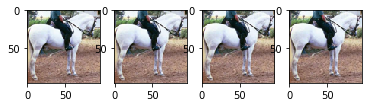

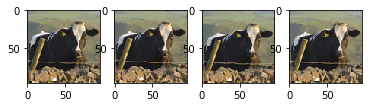

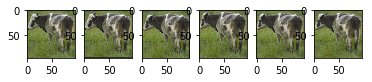

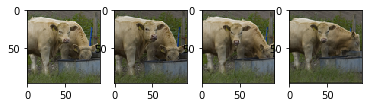

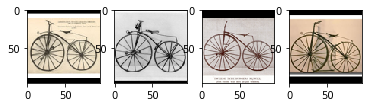

...

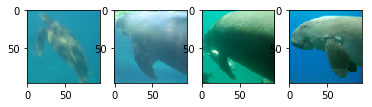

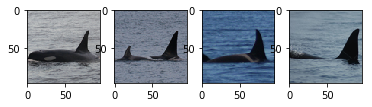

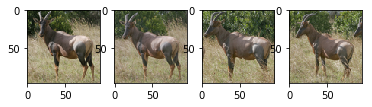

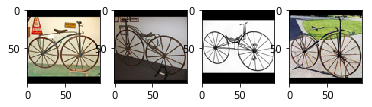

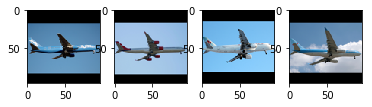

In [14]:
larger_clusters_2 = []
num_3 = 0
num_4 = 0
num_5 = 0
num_6 = 0
num_7 = 0

for child in sub_child_int:
    plot_leaf = []
    plt.figure()

    new_idx = min(child)-leaves
    if (children[new_idx]<leaves).all():
        plot_leaf.append(children[new_idx][0])
        plot_leaf.append(children[new_idx][1])
        
    elif(children[new_idx]<leaves).any():
        plot_leaf.append(min(children[new_idx]))
        new_idx = max(children[new_idx])-leaves
        
        if (children[new_idx]<leaves).all():
            plot_leaf.append(children[new_idx][0])
            plot_leaf.append(children[new_idx][1])
            
        elif(children[new_idx]<leaves).any():
            plot_leaf.append(min(children[new_idx]))
            #print("####### Another internal node ######")
            
            new_idx = max(children[new_idx])-leaves

            if (children[new_idx]<leaves).all():
                plot_leaf.append(children[new_idx][0])
                plot_leaf.append(children[new_idx][1])

            elif(children[new_idx]<leaves).any():
                plot_leaf.append(min(children[new_idx]))
                #print("####### Another internal node ######")
                
                new_idx = max(children[new_idx])-leaves

                if (children[new_idx]<leaves).all():
                    plot_leaf.append(children[new_idx][0])
                    plot_leaf.append(children[new_idx][1])
                    
                elif(children[new_idx]<leaves).any():
                    plot_leaf.append(min(children[new_idx]))
                    #print("####### Another internal node ######")
                    
                    new_idx = max(children[new_idx])-leaves

                    if (children[new_idx]<leaves).all():
                        plot_leaf.append(children[new_idx][0])
                        plot_leaf.append(children[new_idx][1])

                    elif(children[new_idx]<leaves).any():
                        plot_leaf.append(min(children[new_idx]))
                        print("####### Another internal node ######")
 
    new_idx = max(child)-leaves
    if (children[new_idx]<leaves).all():
        plot_leaf.append(children[new_idx][0])
        plot_leaf.append(children[new_idx][1])
        
    elif(children[new_idx]<leaves).any():
        plot_leaf.append(min(children[new_idx]))
        new_idx = max(children[new_idx])-leaves
        
        if (children[new_idx]<leaves).all():
            plot_leaf.append(children[new_idx][0])
            plot_leaf.append(children[new_idx][1])
            
        elif(children[new_idx]<leaves).any():
            plot_leaf.append(min(children[new_idx]))
            #print("####### Another internal node ######")
            
            new_idx = max(children[new_idx])-leaves

            if (children[new_idx]<leaves).all():
                plot_leaf.append(children[new_idx][0])
                plot_leaf.append(children[new_idx][1])

            elif(children[new_idx]<leaves).any():
                plot_leaf.append(min(children[new_idx]))
                #print("####### Another internal node ######")
                
                new_idx = max(children[new_idx])-leaves

                if (children[new_idx]<leaves).all():
                    plot_leaf.append(children[new_idx][0])
                    plot_leaf.append(children[new_idx][1])
                    
                elif(children[new_idx]<leaves).any():
                    plot_leaf.append(min(children[new_idx]))
                    #print("####### Another internal node ######")
                    
                    new_idx = max(children[new_idx])-leaves

                    if (children[new_idx]<leaves).all():
                        plot_leaf.append(children[new_idx][0])
                        plot_leaf.append(children[new_idx][1])

                    elif(children[new_idx]<leaves).any():
                        plot_leaf.append(min(children[new_idx]))
                        print("####### Another internal node ######")
    
    nb_img = len(plot_leaf)
    num = 1
    
    if nb_img == 3:
        num_3 += 1
    
    if nb_img == 4:
        num_4 += 1
    
    if nb_img == 5:
        num_5 += 1

    if nb_img == 6:
        num_6 += 1
        
    if nb_img == 7:
        num_7 += 1

    for img in plot_leaf:
        image = Image.open(images_path + str(img).zfill(6) + '.png')
        plt.subplot(1,nb_img, num)
        plt.imshow(np.asarray(image))
        num += 1
    print(plot_leaf)
    larger_clusters_2.append(plot_leaf)
plt.show()

In [15]:
num_3, num_4, num_5, num_6, num_7

(2, 22, 3, 3, 1)

In [21]:
# writing into a matrix only the node names we want
threshold = 1.25
num =1
child_list = []

for idx, child in enumerate(children):
    if (child<leaves).all() and distances[idx]<threshold:
        # if both children from a particular node are leaves and 
        # the associated distance between them is less than thereshold 
        # the images associated to those leaves are clustered.
        child_list.append(child)

child_array = np.vstack(child_list)
np.save(path_pairs_out + '.npy', child_array)

In [20]:
### REMEMBER TO BUILD TEH CLUSTERS AGAIN WITH ALL THE CHILDRE!!!! ALL OF THEM!!!
if len(sub_child_mixed) > 0:
    #sub_child_mixed_array = np.vstack(sub_child_mixed)
    np.save(path_pairs_out_larger_clusters + '.npy', larger_clusters+larger_clusters_2)

In [21]:
len(larger_clusters), larger_clusters

(317,
 [[17945, 16960, 41537],
  [39597, 24740, 43922],
  [12880, 24662, 48667],
  [38079, 9106, 42620],
  [3742, 10748, 45146],
  [13275, 13117, 16365],
  [49896, 9744, 25365],
  [24679, 28075, 36832],
  [22738, 705, 43598],
  [43173, 49896, 9744, 25365],
  [44029, 14707, 27211],
  [12076, 5483, 28119],
  [23539, 15656, 26372],
  [3050, 28498, 34056],
  [12579, 2683, 11552],
  [19055, 2839, 42561],
  [3746, 1470, 7561],
  [37374, 26350, 34144],
  [31547, 2923, 8904],
  [30311, 35956, 41381],
  [4658, 6479, 23257],
  [19688, 45387, 48783],
  [49416, 22423, 38617],
  [102, 3050, 28498, 34056],
  [3885, 16220, 22236],
  [18510, 14395, 18798],
  [28541, 22126, 49934],
  [36743, 15985, 40654],
  [44498, 9994, 21755],
  [40618, 3721, 35690],
  [23995, 11915, 29113],
  [16455, 16753, 45279],
  [19821, 12725, 33677],
  [8742, 12579, 2683, 11552],
  [43569, 41834, 44437],
  [15923, 21258, 32703],
  [16139, 18510, 14395, 18798],
  [48681, 16922, 41491],
  [24208, 18140, 32913],
  [48644, 6328, 